In [1]:
import os
import math
import numpy as np
import itertools
import tensorflow as tf
from waymo_open_dataset.utils import range_image_utils
from waymo_open_dataset.utils import transform_utils
from waymo_open_dataset.utils import  frame_utils
from waymo_open_dataset import dataset_pb2 as open_dataset
import matplotlib.pyplot as plt
import matplotlib.patches as patches

2023-01-30 12:41:11.009922: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0


In [2]:
FILENAME = '/media/kaai/DATA/waymo_processed/raw_data/segment-15832924468527961_1564_160_1584_160_with_camera_labels.tfrecord'
dataset = tf.data.TFRecordDataset(FILENAME, compression_type='')

2023-01-30 12:41:11.703961: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcuda.so.1
2023-01-30 12:41:11.729853: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-01-30 12:41:11.729928: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1733] Found device 0 with properties: 
pciBusID: 0000:01:00.0 name: NVIDIA GeForce RTX 3090 computeCapability: 8.6
coreClock: 1.785GHz coreCount: 82 deviceMemorySize: 23.69GiB deviceMemoryBandwidth: 871.81GiB/s
2023-01-30 12:41:11.729940: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0
2023-01-30 12:41:11.732249: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcublas.so.11
2023-01-30 12:41:11.732275: I tensorflow/stream_executor/pl

In [3]:
for data in dataset:
    frame = open_dataset.Frame()
    frame.ParseFromString(bytearray(data.numpy()))
    break

2023-01-30 12:41:12.059301: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:176] None of the MLIR Optimization Passes are enabled (registered 2)
2023-01-30 12:41:12.078372: I tensorflow/core/platform/profile_utils/cpu_utils.cc:114] CPU Frequency: 2496000000 Hz


In [4]:
(range_images, camera_projections, range_image_top_pose) = frame_utils.parse_range_image_and_camera_projection(frame) #解析数据帧

In [5]:
(point,cp_point) = frame_utils.convert_range_image_to_point_cloud(frame,range_images,camera_projections,range_image_top_pose)#获取激光点云

2023-01-30 12:41:12.378635: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcublas.so.11
2023-01-30 12:41:12.845197: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcublasLt.so.11
2023-01-30 12:41:12.868457: I tensorflow/stream_executor/cuda/cuda_blas.cc:1838] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.
2023-01-30 12:41:12.956603: I tensorflow/core/util/cuda_solvers.cc:180] Creating CudaSolver handles for stream 0x588ece0
2023-01-30 12:41:12.956658: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcusolver.so.11
2023-01-30 12:41:12.995266: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcublas.so.11


In [6]:
print(frame.context)

name: "15832924468527961_1564_160_1584_160"
camera_calibrations {
  name: FRONT
  intrinsic: 2084.2156571134137
  intrinsic: 2084.2156571134137
  intrinsic: 982.6994065605393
  intrinsic: 647.3422876254992
  intrinsic: 0.05522255992596878
  intrinsic: -0.3600927587289719
  intrinsic: 0.0006210752927545161
  intrinsic: 0.0013973870200010682
  intrinsic: 0.0
  extrinsic {
    transform: 0.9996870267605353
    transform: -0.0030484762173332465
    transform: -0.02483053200060265
    transform: 1.5443633552511271
    transform: 0.0035381381029361398
    transform: 0.9997996727443175
    transform: 0.019700151246131364
    transform: -0.022670639905103627
    transform: 0.024765502325718128
    transform: -0.019781839477365427
    transform: 0.9994975481317834
    transform: 2.115798553138532
    transform: 0.0
    transform: 0.0
    transform: 0.0
    transform: 1.0
  }
  width: 1920
  height: 1280
  rolling_shutter_direction: RIGHT_TO_LEFT
}
camera_calibrations {
  name: FRONT_LEFT
  intr

In [7]:
(range_images, camera_projections,range_image_top_pose) = frame_utils.parse_range_image_and_camera_projection(frame)

In [8]:
print(frame.context)

name: "15832924468527961_1564_160_1584_160"
camera_calibrations {
  name: FRONT
  intrinsic: 2084.2156571134137
  intrinsic: 2084.2156571134137
  intrinsic: 982.6994065605393
  intrinsic: 647.3422876254992
  intrinsic: 0.05522255992596878
  intrinsic: -0.3600927587289719
  intrinsic: 0.0006210752927545161
  intrinsic: 0.0013973870200010682
  intrinsic: 0.0
  extrinsic {
    transform: 0.9996870267605353
    transform: -0.0030484762173332465
    transform: -0.02483053200060265
    transform: 1.5443633552511271
    transform: 0.0035381381029361398
    transform: 0.9997996727443175
    transform: 0.019700151246131364
    transform: -0.022670639905103627
    transform: 0.024765502325718128
    transform: -0.019781839477365427
    transform: 0.9994975481317834
    transform: 2.115798553138532
    transform: 0.0
    transform: 0.0
    transform: 0.0
    transform: 1.0
  }
  width: 1920
  height: 1280
  rolling_shutter_direction: RIGHT_TO_LEFT
}
camera_calibrations {
  name: FRONT_LEFT
  intr

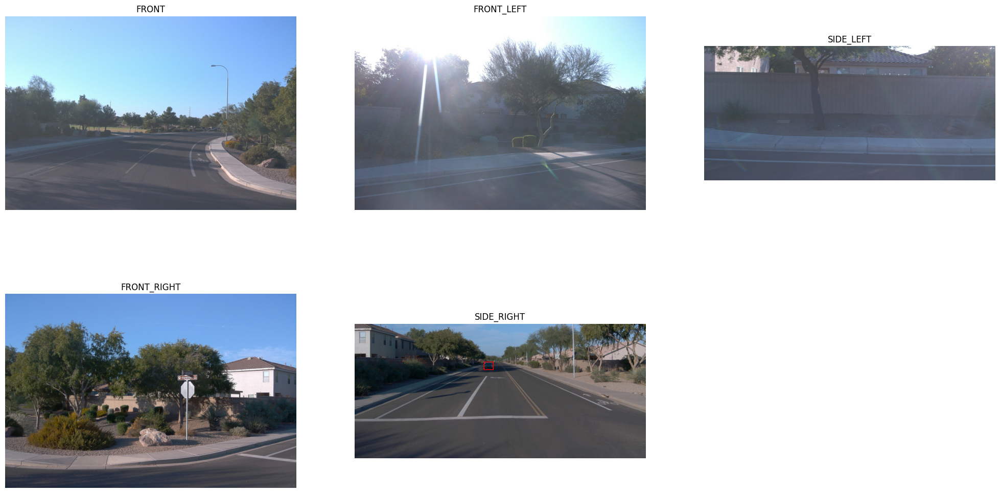

In [9]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches

def show_camera_image(camera_image, camera_labels, layout, cmap=None):
  """Show a camera image and the given camera labels."""

  ax = plt.subplot(*layout)

  # Draw the camera labels.
  for camera_labels in frame.camera_labels:
    # Ignore camera labels that do not correspond to this camera.
    if camera_labels.name != camera_image.name:
      continue

    # Iterate over the individual labels.
    for label in camera_labels.labels:
      # Draw the object bounding box.
      ax.add_patch(patches.Rectangle(
        xy=(label.box.center_x - 0.5 * label.box.length,
            label.box.center_y - 0.5 * label.box.width),
        width=label.box.length,
        height=label.box.width,
        linewidth=1,
        edgecolor='red',
        facecolor='none'))

  # Show the camera image.
  plt.imshow(tf.image.decode_jpeg(camera_image.image), cmap=cmap)
  plt.title(open_dataset.CameraName.Name.Name(camera_image.name))
  plt.grid(False)
  plt.axis('off')

plt.figure(figsize=(25, 20))

for index, image in enumerate(frame.images):
  show_camera_image(image, frame.camera_labels, [3, 3, index+1])

In [10]:
plt.figure(figsize=(64, 20))
def plot_range_image_helper(data, name, layout, vmin = 0, vmax=1, cmap='gray'):
  """Plots range image.

  Args:
    data: range image data
    name: the image title
    layout: plt layout
    vmin: minimum value of the passed data
    vmax: maximum value of the passed data
    cmap: color map
  """
  plt.subplot(*layout)
  plt.imshow(data, cmap=cmap, vmin=vmin, vmax=vmax)
  plt.title(name)
  plt.grid(False)
  plt.axis('off')

<Figure size 6400x2000 with 0 Axes>

In [11]:
def get_range_image(laser_name, return_index):
  """Returns range image given a laser name and its return index."""
  return range_images[laser_name][return_index]

In [12]:
def show_range_image(range_image, layout_index_start = 1):
  """Shows range image.

  Args:
    range_image: the range image data from a given lidar of type MatrixFloat.
    layout_index_start: layout offset
  """
  range_image_tensor = tf.convert_to_tensor(range_image.data)
  range_image_tensor = tf.reshape(range_image_tensor, range_image.shape.dims)
  lidar_image_mask = tf.greater_equal(range_image_tensor, 0)
  #x = tf.constant([5, 4, 6, 7])
  #y = tf.constant([5, 2, 5, 10])
  #tf.math.greater_equal(x, y) ==> [True, True, True, False]
  #  This results in the output tensor having large values for those elements where ”lidar_image_mask“ is False, 
  #  and the original values from ”range_image_tensor“ where “lidar_image_mask” is True.
  range_image_tensor = tf.where(lidar_image_mask, range_image_tensor,
                                tf.ones_like(range_image_tensor) * 1e10)
  
  range_image_range = range_image_tensor[...,0] 
  range_image_intensity = range_image_tensor[...,1]
  range_image_elongation = range_image_tensor[...,2]
  plot_range_image_helper(range_image_range.numpy(), 'range',
                   [8, 1, layout_index_start], vmax=75, cmap='gray')
  plot_range_image_helper(range_image_intensity.numpy(), 'intensity',
                   [8, 1, layout_index_start + 1], vmax=1.5, cmap='gray')
  plot_range_image_helper(range_image_elongation.numpy(), 'elongation',
                   [8, 1, layout_index_start + 2], vmax=1.5, cmap='gray')

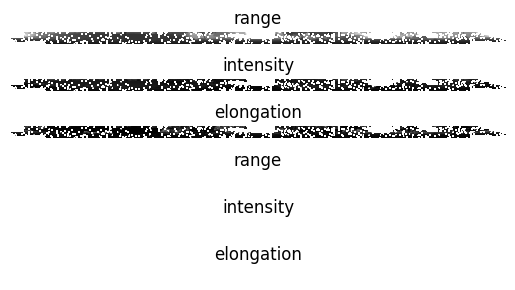

In [13]:
frame.lasers.sort(key=lambda laser: laser.name)
show_range_image(get_range_image(open_dataset.LaserName.TOP, 0), 1)
show_range_image(get_range_image(open_dataset.LaserName.TOP, 1), 4)

In [14]:
range_image = range_images[1][0]

In [15]:
range_image

data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0
data: -1.0

In [16]:
range_image_tensor = tf.convert_to_tensor(range_image.data)

In [17]:
range_image_tensor

<tf.Tensor: shape=(678400,), dtype=float32, numpy=array([-1., -1., -1., ..., -1., -1., -1.], dtype=float32)>

In [18]:
range_image_tensor = tf.reshape(range_image_tensor, range_image.shape.dims)

In [19]:
range_image_tensor

<tf.Tensor: shape=(64, 2650, 4), dtype=float32, numpy=
array([[[-1., -1., -1., -1.],
        [-1., -1., -1., -1.],
        [-1., -1., -1., -1.],
        ...,
        [-1., -1., -1., -1.],
        [-1., -1., -1., -1.],
        [-1., -1., -1., -1.]],

       [[-1., -1., -1., -1.],
        [-1., -1., -1., -1.],
        [-1., -1., -1., -1.],
        ...,
        [-1., -1., -1., -1.],
        [-1., -1., -1., -1.],
        [-1., -1., -1., -1.]],

       [[-1., -1., -1., -1.],
        [-1., -1., -1., -1.],
        [-1., -1., -1., -1.],
        ...,
        [-1., -1., -1., -1.],
        [-1., -1., -1., -1.],
        [-1., -1., -1., -1.]],

       ...,

       [[-1., -1., -1., -1.],
        [-1., -1., -1., -1.],
        [-1., -1., -1., -1.],
        ...,
        [-1., -1., -1., -1.],
        [-1., -1., -1., -1.],
        [-1., -1., -1., -1.]],

       [[-1., -1., -1., -1.],
        [-1., -1., -1., -1.],
        [-1., -1., -1., -1.],
        ...,
        [-1., -1., -1., -1.],
        [-1., -1., 

In [20]:
points, cp_points = frame_utils.convert_range_image_to_point_cloud(
    frame,
    range_images,
    camera_projections,
    range_image_top_pose)
points_ri2, cp_points_ri2 = frame_utils.convert_range_image_to_point_cloud(
    frame,
    range_images,
    camera_projections,
    range_image_top_pose,
    ri_index=1)

# 3d points in vehicle frame.
points_all = np.concatenate(points, axis=0)
points_all_ri2 = np.concatenate(points_ri2, axis=0)
# camera projection corresponding to each point.
cp_points_all = np.concatenate(cp_points, axis=0)
cp_points_all_ri2 = np.concatenate(cp_points_ri2, axis=0)

In [21]:
points

[array([[-7.2070312e+01,  9.2500000e+00,  5.3429565e+00],
        [-7.2394531e+01,  9.4677734e+00,  5.3590088e+00],
        [-7.1733398e+01,  9.5571289e+00,  5.3322144e+00],
        ...,
        [-4.1591797e+00, -2.7666016e+00,  7.9040527e-03],
        [-4.2675781e+00, -2.7958984e+00, -2.7618408e-02],
        [-4.3046875e+00, -2.7944336e+00, -3.8208008e-02]], dtype=float32),
 array([[ 18.25576   ,  -7.6350665 ,   4.7961745 ],
        [ 16.587856  ,  -8.921576  ,   4.6375847 ],
        [ 16.142668  , -10.228026  ,   4.774467  ],
        ...,
        [  4.056584  ,   0.08490307,   0.05275476],
        [  4.071018  ,   0.07776955,   0.0524298 ],
        [  4.0962224 ,   0.06264047,   0.05850869]], dtype=float32),
 array([[-4.6305275 , 11.820968  ,  4.6294456 ],
        [-4.2000837 , 12.183796  ,  4.636199  ],
        [-3.0823126 , 11.185627  ,  4.2376995 ],
        ...,
        [ 3.3029635 ,  1.0944219 ,  0.062747  ],
        [ 3.3141358 ,  1.0831172 ,  0.06197679],
        [ 3.2829843 , 

In [22]:
points_all

array([[-7.2070312e+01,  9.2500000e+00,  5.3429565e+00],
       [-7.2394531e+01,  9.4677734e+00,  5.3590088e+00],
       [-7.1733398e+01,  9.5571289e+00,  5.3322144e+00],
       ...,
       [-1.1546874e+00, -5.6755587e-02,  7.7009678e-02],
       [-1.1321840e+00, -2.5922291e-02,  6.3465297e-02],
       [-1.1619834e+00, -2.7347865e-02,  6.9266289e-02]], dtype=float32)

In [23]:
cp_points

[array([[0, 0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0, 0],
        ...,
        [0, 0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0, 0]], dtype=int32),
 array([[  3, 200, 316,   0,   0,   0],
        [  3, 440, 335,   0,   0,   0],
        [  3, 603, 333,   0,   0,   0],
        ...,
        [  0,   0,   0,   0,   0,   0],
        [  0,   0,   0,   0,   0,   0],
        [  0,   0,   0,   0,   0,   0]], dtype=int32),
 array([[0, 0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0, 0],
        ...,
        [0, 0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0, 0]], dtype=int32),
 array([[  3, 331, 281,   0,   0,   0],
        [  3, 414, 306,   0,   0,   0],
        [  3, 495, 298,   0,   0,   0],
        ...,
        [  0,   0,   0,   0,   0,   0],
        [  0,   0,   0,   0,   0,   0],
        [  0,   0,   0,   0,   0,   0]], dtype=int32),
 array([[0, 0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0, 0],
        [0, 0, 0

In [24]:
print("points_all.shape",points_all.shape)
print("cp_points_all.shape",cp_points_all.shape)
print("points_all[0:2]",points_all[0:2])
for i in range(5):
  print(points[i].shape)
  print(cp_points[i].shape)

points_all.shape (169035, 3)
cp_points_all.shape (169035, 6)
points_all[0:2] [[-72.07031     9.25        5.3429565]
 [-72.39453     9.467773    5.359009 ]]
(153271, 3)
(153271, 6)
(3562, 3)
(3562, 6)
(4397, 3)
(4397, 6)
(3944, 3)
(3944, 6)
(3861, 3)
(3861, 6)


In [25]:
images = sorted(frame.images, key=lambda i:i.name)
cp_points_all_concat = np.concatenate([cp_points_all, points_all], axis=-1)
cp_points_all_concat_tensor = tf.constant(cp_points_all_concat)

In [26]:
frame.images

[name: FRONT
image: "\377\330\377\340\000\020JFIF\000\001\001\000\000\001\000\001\000\000\377\333\000\204\000\003\002\002\003\002\002\003\003\003\003\004\003\003\004\005\010\005\005\004\004\005\n\007\007\006\010\014\n\014\014\013\n\013\013\r\016\022\020\r\016\021\016\013\013\020\026\020\021\023\024\025\025\025\014\017\027\030\026\024\030\022\024\025\024\001\003\004\004\005\004\005\t\005\005\t\024\r\013\r\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\377\300\000\021\010\005\000\007\200\003\001\"\000\002\021\001\003\021\001\377\304\000\035\000\000\002\003\001\001\001\001\001\000\000\000\000\000\000\000\000\001\002\000\003\004\005\006\007\010\t\377\304\000N\020\000\001\003\003\003\002\005\002\004\005\002\004\005\001\000\023\001\000\002\021\003\004!\0221A\005Q\006\023\"aq2\201\007\024\221\241#BR\261\301\025\321\0103b\341\026$r\202\360\361

In [27]:
# The distance between lidar points and vehicle frame origin.
points_all_tensor = tf.norm(points_all, axis=-1, keepdims=True)
cp_points_all_tensor = tf.constant(cp_points_all, dtype=tf.int32)

mask = tf.equal(cp_points_all_tensor[..., 0], images[0].name)

cp_points_all_tensor = tf.cast(tf.gather_nd(
    cp_points_all_tensor, tf.where(mask)), dtype=tf.float32)
points_all_tensor = tf.gather_nd(points_all_tensor, tf.where(mask))

projected_points_all_from_raw_data = tf.concat(
    [cp_points_all_tensor[..., 1:3], points_all_tensor], axis=-1).numpy()

In [28]:
image

name: SIDE_RIGHT
image: "\377\330\377\340\000\020JFIF\000\001\001\000\000\001\000\001\000\000\377\333\000\204\000\003\002\002\003\002\002\003\003\003\003\004\003\003\004\005\010\005\005\004\004\005\n\007\007\006\010\014\n\014\014\013\n\013\013\r\016\022\020\r\016\021\016\013\013\020\026\020\021\023\024\025\025\025\014\017\027\030\026\024\030\022\024\025\024\001\003\004\004\005\004\005\t\005\005\t\024\r\013\r\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\377\300\000\021\010\003v\007\200\003\001\"\000\002\021\001\003\021\001\377\304\000\035\000\000\001\005\001\001\001\001\000\000\000\000\000\000\000\000\000\002\000\001\003\004\005\006\007\010\t\377\304\000R\020\000\001\003\003\003\003\003\002\004\003\006\005\002\002\000\027\001\002\003\021\000\004!\005\0221\006AQ\023\"a\007q\0242\201\221#B\241\010\025R\261\301\321\026$3b\341Cr\0274\202\

In [29]:
def rgba(r):
  """Generates a color based on range.

  Args:
    r: the range value of a given point.
  Returns:
    The color for a given range
  """
  c = plt.get_cmap('jet')((r % 20.0) / 20.0)
  c = list(c)
  c[-1] = 0.5  # alpha
  return c


In [30]:
def plot_image(camera_image):
  """Plot a cmaera image."""
  plt.figure(figsize=(20, 12))
  plt.imshow(tf.image.decode_jpeg(camera_image.image))
  plt.grid("off")

In [31]:
def plot_points_on_image(projected_points, camera_image, rgba_func,
                         point_size=5.0):
  """Plots points on a camera image.

  Args:
    projected_points: [N, 3] numpy array. The inner dims are
      [camera_x, camera_y, range].
    camera_image: jpeg encoded camera image.
    rgba_func: a function that generates a color from a range value.
    point_size: the point size.

  """
  plot_image(camera_image)

  xs = []
  ys = []
  colors = []

  for point in projected_points:
    xs.append(point[0])  # width, col
    ys.append(point[1])  # height, row
    colors.append(rgba_func(point[2]))

  plt.scatter(xs, ys, c=colors, s=point_size, edgecolors="none")

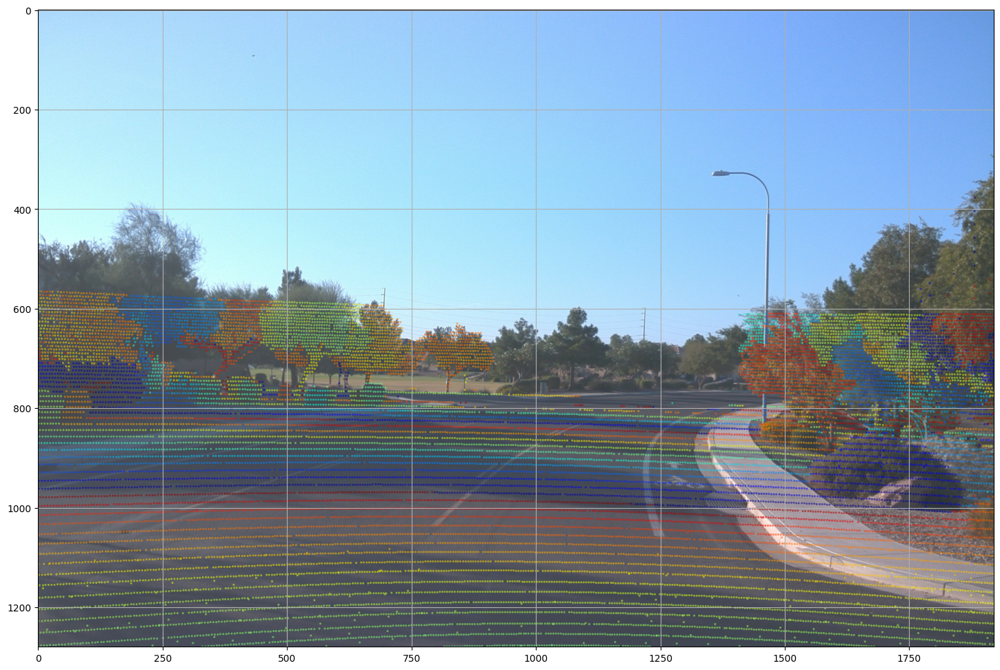

In [32]:
plot_points_on_image(projected_points_all_from_raw_data,
                     images[0], rgba, point_size=5.0)

In [33]:
(range_images, camera_projections, range_image_top_pose) = frame_utils.parse_range_image_and_camera_projection(frame)
points, cp_points = frame_utils.convert_range_image_to_point_cloud(frame, range_images, camera_projections, range_image_top_pose) 
points_all = np.concatenate(points, axis=0)


In [34]:
from mayavi import mlab
def pc_show(points):
  fig = mlab.figure(bgcolor=(0, 0, 0), size=(640, 500))
  x = points[:,0]
  y = points[:,1]
  z = points[:,2]
  col = z
  print(x.shape)
  mlab.points3d(x, y, z,
                      col,  # Values used for Color
                      mode="point",
                      colormap='spectral',  # 'bone', 'copper', 'gnuplot'
                      # color=(0, 1, 0),   # Used a fixed (r,g,b) instead
                      figure=fig,
                      )
  mlab.show()

pc_show(cp_point)

ImportError: Could not import backend for traitsui.  Make sure you
        have a suitable UI toolkit like PyQt/PySide or wxPython
        installed.